In [ ]:
!pip install segmentation_models_3D



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.8/69.8 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 35.6 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires keras<2.16,>=2.15.0, but you have keras 3.3.3 which is incompatible.


In [ ]:
import tensorflow
import segmentation_models_3D as sm
from tensorflow.keras import mixed_precision

Segmentation Models: using `tf.keras` framework.


In [ ]:
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_global_policy(policy)

In [ ]:
import os
from google.colab import files
from google.cloud import storage

uploaded = files.upload()

In [ ]:
key_file = list(uploaded.keys())[0]
os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = key_file

client = storage.Client()

bucket_name = 'majorprojectz'
bucket = client.bucket(bucket_name)

In [1]:
import numpy as np
import os
from scipy.ndimage import map_coordinates, gaussian_filter, rotate
import random
from io import BytesIO

In [ ]:
def random_rotate(image, mask):
    angle = np.random.randint(0, 360)
    axes = (0, 1)
    rotated_image = rotate(image, angle=angle, axes=axes, reshape=False, mode='reflect')
    rotated_mask = rotate(mask, angle=angle, axes=axes, reshape=False, mode='reflect')
    return rotated_image, rotated_mask

In [ ]:
def random_flip(image, mask):
    if np.random.rand() < 0.5:
        axis = np.random.choice([0, 1])
        image = np.flip(image, axis=axis)
        mask = np.flip(mask, axis=axis)
    return image, mask

In [ ]:
import numpy as np
from scipy.ndimage import gaussian_filter, map_coordinates

def elastic_deform(image, mask, alpha=720, sigma=24):

    random_state = np.random.RandomState(None)
    shape = image.shape[:3]


    dx = gaussian_filter((random_state.rand(*shape) * 2 - 1), sigma, mode="constant", cval=0) * alpha
    dy = gaussian_filter((random_state.rand(*shape) * 2 - 1), sigma, mode="constant", cval=0) * alpha
    dz = gaussian_filter((random_state.rand(*shape) * 2 - 1), sigma, mode="constant", cval=0) * alpha


    x, y, z = np.meshgrid(np.arange(shape[0]), np.arange(shape[1]), np.arange(shape[2]), indexing='ij')


    distorted_x = x + dx
    distorted_y = y + dy
    distorted_z = z + dz


    distorted_image = np.zeros_like(image)
    for c in range(image.shape[3]):
        distorted_image[..., c] = map_coordinates(image[..., c], [distorted_x.ravel(), distorted_y.ravel(), distorted_z.ravel()], order=1, mode='reflect').reshape(shape)

    distorted_mask = np.zeros_like(mask)
    for c in range(mask.shape[3]):
        distorted_mask[..., c] = map_coordinates(mask[..., c], [distorted_x.ravel(), distorted_y.ravel(), distorted_z.ravel()], order=1, mode='reflect').reshape(shape)

    return distorted_image, distorted_mask

In [ ]:
def augmented_image_data(image, mask):
    image, mask = random_rotate(image, mask)

    image, mask = random_flip(image, mask)

    if np.random.rand() > 0.7:
        image, mask = elastic_deform(image, mask,alpha=720,sigma=24)
    return image, mask

In [ ]:
from io import BytesIO
import numpy as np
from multiprocessing import Pool
from functools import partial

def imageloader(bucket, img_dir, img_list, mask_dir, mask_list, batch_size,augment=True):
    L = len(img_list)
    assert len(img_list) == len(mask_list), "Image list and mask list must have the same length."

    while True:  # Infinite loop to continuously yield data
        for start in range(0, L, batch_size):
            end = min(start + batch_size, L)
            batch_img_list = img_list[start:end]
            batch_mask_list = mask_list[start:end]

            
            imgs = [load_npy_from_gcs(bucket, img_dir, img_name) for img_name in batch_img_list]
            masks = [load_npy_from_gcs(bucket, mask_dir, mask_name) for mask_name in batch_mask_list]

            if augment:
                augmented_imgs_masks = [augmented_image_data(img, mask) for img, mask in zip(imgs, masks)]
                imgs, masks = zip(*augmented_imgs_masks)

            yield (np.array(imgs), np.array(masks))

def load_npy_from_gcs(bucket, dir_name, blob_name):
    """Load a numpy array from a GCS blob."""
    full_blob_name = dir_name + blob_name
    blob = bucket.blob(full_blob_name)
    byte_data = blob.download_as_bytes()
    return np.load(BytesIO(byte_data))


In [ ]:
from matplotlib import pyplot as plt
import random

In [ ]:
def list_gcs_files(bucket, prefix):
    if not prefix.endswith('/'):
        prefix += '/'

    blobs = bucket.list_blobs(prefix=prefix)
    files = [blob.name[len(prefix):] for blob in blobs if '/' not in blob.name[len(prefix):]]
    return files

In [ ]:
train_img_dir = "input_data_128/train/images/"
train_mask_dir = "input_data_128/train/masks/"

train_img_list = list_gcs_files(bucket, train_img_dir)
train_mask_list = list_gcs_files(bucket, train_mask_dir)


In [ ]:
batch_size = 20
train_img_datagen = imageloader(bucket, train_img_dir, train_img_list,
                                    train_mask_dir, train_mask_list, batch_size)

In [ ]:
imgs, masks = next(train_img_datagen)

In [ ]:
img_num = random.randint(0, imgs.shape[0] - 1)
test_img = imgs[img_num]
test_mask = masks[img_num]
test_mask = np.argmax(test_mask, axis=3)

In [ ]:
from matplotlib.animation import FuncAnimation

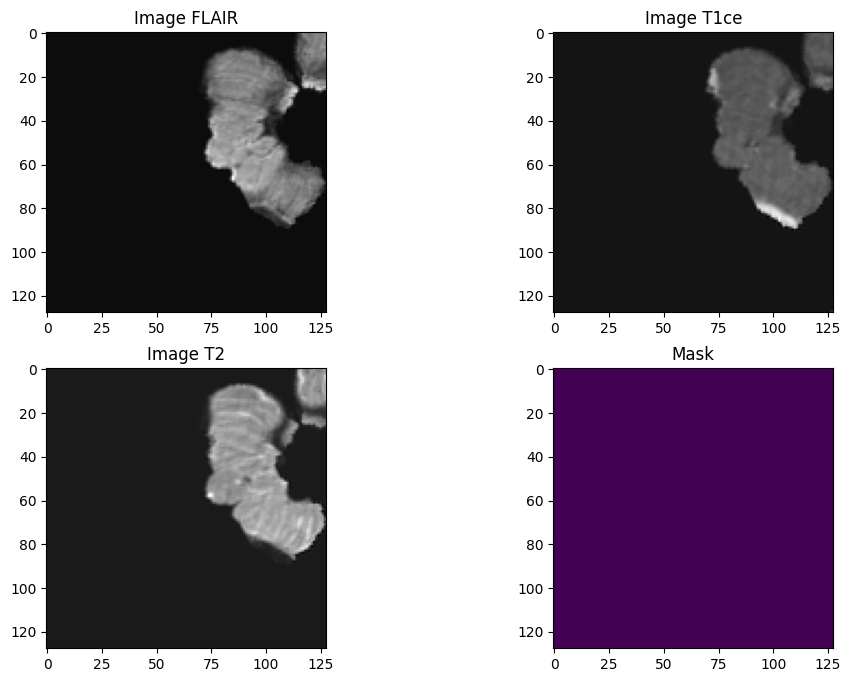

In [ ]:
def animate(i):
    plt.clf()
    slice_index = i % test_img.shape[2]

    plt.subplot(221)
    plt.imshow(test_img[:, :, slice_index, 0], cmap='gray')
    plt.title('Image FLAIR')

    plt.subplot(222)
    plt.imshow(test_img[:, :, slice_index, 1], cmap='gray')
    plt.title('Image T1ce')

    plt.subplot(223)
    plt.imshow(test_img[:, :, slice_index, 2], cmap='gray')
    plt.title('Image T2')

    plt.subplot(224)
    plt.imshow(test_mask[:, :, slice_index])
    plt.title('Mask')

fig = plt.figure(figsize=(12, 8))
ani = FuncAnimation(fig, animate, frames=60, interval=200)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [ ]:
val_img_dir = "input_data_128/val/images/"
val_mask_dir = "input_data_128/val/masks/"

val_img_list = sorted(list_gcs_files(bucket, val_img_dir))
val_mask_list = sorted(list_gcs_files(bucket, val_mask_dir))

In [ ]:
train_img_list = sorted(train_img_list)
train_mask_list = sorted(train_mask_list)


In [ ]:
val_img_datagen = imageloader(bucket, val_img_dir, val_img_list,
                                    val_mask_dir, val_mask_list, batch_size)

In [8]:
from keras.models import Model
from keras.layers import Input, Conv3D, MaxPooling3D, Conv3DTranspose, concatenate, Dropout, Activation, BatchNormalization, add, Multiply, Lambda
from keras.optimizers import Adam
from keras.metrics import MeanIoU
import keras.backend as k

def attention_gate(input, gating_signal, inter_channels):
    theta_x = Conv3D(inter_channels, (2, 2, 2), strides=(2, 2, 2), padding='same')(input)
    phi_g = Conv3D(inter_channels, (1, 1, 1), padding='same')(gating_signal)
    add_xg = add([theta_x, phi_g])
    act_xg = Activation('relu')(add_xg)
    psi = Conv3D(1, (1, 1, 1), padding='same', activation='sigmoid')(act_xg)
    upsample_psi = Conv3DTranspose(1, (2, 2, 2), strides=(2, 2, 2), padding='same')(psi)
    output = Multiply()([input, upsample_psi])
    return output

def ResoNet3D(IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS, num_classes):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS))
    s = inputs

    def res_block(x, n_filters, dropout):
        res = Conv3D(n_filters, (3, 3, 3), activation=None, kernel_initializer='he_normal', padding='same')(x)
        res = BatchNormalization()(res)
        res = Activation('relu')(res)

        res = Conv3D(n_filters, (3, 3, 3), activation=None, kernel_initializer='he_normal', padding='same')(res)
        res = BatchNormalization()(res)

        shortcut = Conv3D(n_filters, (1, 1, 1), activation=None, kernel_initializer='he_normal', padding='same')(x)
        shortcut = BatchNormalization()(shortcut)
        res = add([shortcut, res])
        res = Activation('relu')(res)
        if dropout > 0:
            res = Dropout(dropout)(res)
        return res

    c1 = res_block(s, 16, 0.1)
    p1 = MaxPooling3D((2, 2, 2))(c1)
    c2 = res_block(p1, 32, 0.1)
    p2 = MaxPooling3D((2, 2, 2))(c2)
    c3 = res_block(p2, 64, 0.2)
    p3 = MaxPooling3D((2, 2, 2))(c3)
    c4 = res_block(p3, 128, 0.2)
    p4 = MaxPooling3D((2, 2, 2))(c4)
    c5 = res_block(p4, 256, 0.3)

    u6 = Conv3DTranspose(128, (2, 2, 2), strides=(2, 2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    u6 = attention_gate(u6, c5, 128)
    c6 = res_block(u6, 128, 0.2)
    u7 = Conv3DTranspose(64, (2, 2, 2), strides=(2, 2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    u7 = attention_gate(u7, c6, 64)
    c7 = res_block(u7, 64, 0.2)
    u8 = Conv3DTranspose(32, (2, 2, 2), strides=(2, 2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    u8 = attention_gate(u8, c7, 32)
    c8 = res_block(u8, 32, 0.1)
    u9 = Conv3DTranspose(16, (2, 2, 2), strides=(2, 2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1])
    u9 = attention_gate(u9, c8, 16)
    c9 = res_block(u9, 16, 0.1)

    outputs = Conv3D(num_classes, (1, 1, 1), activation='softmax')(c9)
    model = Model(inputs=[inputs], outputs=[outputs])
    model.summary()

    return model

model = ResoNet3D(128, 128, 128, 3, 4)
print(model.input_shape)
print(model.output_shape)




Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 128, 128, 128, 3)]   0         []                            
                                                                                                  
 conv3d_7 (Conv3D)           (None, 128, 128, 128, 16)    1312      ['input_4[0][0]']             
                                                                                                  
 batch_normalization_7 (Bat  (None, 128, 128, 128, 16)    64        ['conv3d_7[0][0]']            
 chNormalization)                                                                                 
                                                                                                  
 activation_2 (Activation)   (None, 128, 128, 128, 16)    0         ['batch_normalization_7[0]

In [ ]:
def load_npy_from_gcs(blob_name):
    """Load a numpy array from a GCS blob."""
    blob = bucket.blob(blob_name)
    byte_data = blob.download_as_bytes()
    return np.load(BytesIO(byte_data))

In [ ]:
import pandas as pd
columns = ['0', '1', '2', '3']
data = []

for img_path in train_mask_list:
    full_path = train_mask_dir + img_path
    temp_image = load_npy_from_gcs(full_path)
    temp_image = np.argmax(temp_image, axis=3)
    val, counts = np.unique(temp_image, return_counts=True)


    counts_dict = dict.fromkeys(columns, 0)

    counts_dict.update({str(v): c for v, c in zip(val, counts)})

    data.append(counts_dict)

df = pd.DataFrame(data)

label_sums = df.sum()

total_labels = label_sums.sum()

n_classes = len(columns)

weights = total_labels / (n_classes * label_sums)

weights = weights.round(2)

print("Class Weights:", weights.values)

In [9]:
IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS = 128, 128, 128, 3
num_classes = 4
batch_size = 20

In [ ]:
train_img_datagen = imageloader(bucket, train_img_dir, train_img_list,
                                    train_mask_dir, train_mask_list, batch_size,augment=True)

In [ ]:
val_img_datagen = imageloader(bucket, val_img_dir, val_img_list,
                                    val_mask_dir, val_mask_list, batch_size,augment=True)

In [10]:
model =  ResoNet3D(IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS, num_classes)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 128, 128, 128, 3)]   0         []                            
                                                                                                  
 conv3d_47 (Conv3D)          (None, 128, 128, 128, 16)    1312      ['input_5[0][0]']             
                                                                                                  
 batch_normalization_34 (Ba  (None, 128, 128, 128, 16)    64        ['conv3d_47[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_24 (Activation)  (None, 128, 128, 128, 16)    0         ['batch_normalization_34

In [ ]:
import numpy as np
import tensorflow as tf

In [ ]:
class_weights = np.array([0.25, 0.25, 0.25, 0.25])

In [ ]:
import tensorflow as tf
def categorical_focal_loss(gamma, alpha):

    def focal_loss(y_true, y_pred):
        epsilon = tf.keras.backend.epsilon()
        y_pred = tf.clip_by_value(y_pred, epsilon, 1. - epsilon)

        cross_entropy = -y_true * tf.math.log(y_pred)

        loss = alpha * tf.math.pow(1 - y_pred, gamma) * cross_entropy

        return tf.reduce_mean(tf.reduce_sum(loss, axis=-1))

    return focal_loss


In [ ]:
def combined_loss(gamma, alpha, class_weights):

    dice_loss = sm.losses.DiceLoss(class_weights=class_weights)
    focal_loss = categorical_focal_loss(gamma, alpha)

    def loss(y_true, y_pred):
        return dice_loss(y_true, y_pred) + focal_loss(y_true, y_pred)

    return loss

In [ ]:
focal_loss = categorical_focal_loss(2,0.25)
total_loss = combined_loss(2,0.25,class_weights)

In [ ]:
import keras

In [ ]:
model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.00014,clipnorm=1.0),
              loss=total_loss,
              metrics=['accuracy', sm.metrics.IOUScore(threshold=0.5)])

In [ ]:
steps_per_epoch = len(train_img_list) // batch_size
val_steps_per_epoch = len(val_img_list) // batch_size

In [ ]:
history = model.fit(train_img_datagen,
                     steps_per_epoch=steps_per_epoch,
                     epochs=95,
                     verbose=1,
                     validation_data=val_img_datagen,
                     validation_steps=val_steps_per_epoch)


Epoch 1/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 512s 30s/step - accuracy: 0.2992 - iou_score: 0.0266 - loss: 1.1280 - val_accuracy: 0.9288 - val_iou_score: 0.1573 - val_loss: 1.0208
Epoch 2/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 281s 19s/step - accuracy: 0.9281 - iou_score: 0.2053 - loss: 1.0089 - val_accuracy: 0.9459 - val_iou_score: 0.1589 - val_loss: 0.9968
Epoch 3/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 177s 16s/step - accuracy: 0.9570 - iou_score: 0.2302 - loss: 0.9735 - val_accuracy: 0.9491 - val_iou_score: 0.1615 - val_loss: 0.9914
Epoch 4/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 207s 17s/step - accuracy: 0.9574 - iou_score: 0.2341 - loss: 0.9660 - val_accuracy: 0.9494 - val_iou_score: 0.1687 - val_loss: 0.9828
Epoch 5/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 229s 19s/step - accuracy: 0.9534 - iou_score: 0.2305 - loss: 0.9631 - val_accuracy: 0.9508 - val_iou_score: 0.1626 - val_loss: 0.9872
Epoch 6/95
12/12 ━━━━━━━━━━━━━━━━━━━━ 214s 18s/step - accuracy: 0.9516 - iou_score: 0.2293 - loss: 0.9637 - val_accuracy: 0.9488 - val_iou_s

In [ ]:
model.save('residual13d.keras')

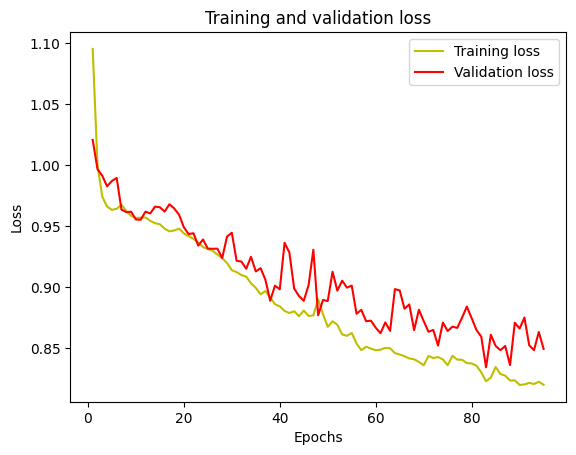

In [ ]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

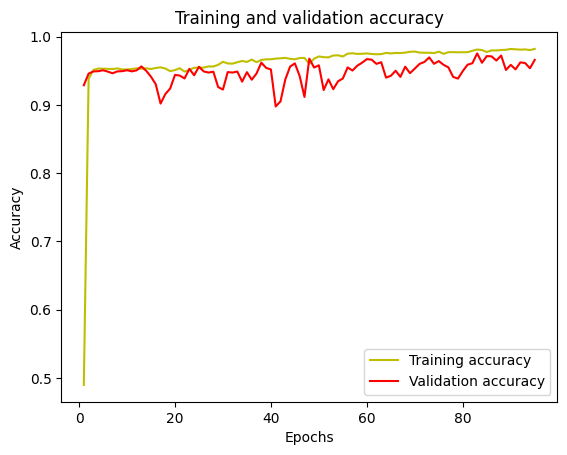

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

plt.plot(epochs, acc, 'y', label='Training accuracy')
plt.plot(epochs, val_acc, 'r', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
from keras.models import load_model

In [ ]:
my_model = load_model('residual13d.h5',
                      compile=False)

In [ ]:
from keras.metrics import MeanIoU

batch_size=8 
test_img_datagen = imageloader(bucket,val_img_dir, val_img_list,
                                val_mask_dir, val_mask_list, batch_size)

In [ ]:
test_image_batch, test_mask_batch = test_img_datagen.__next__()

In [ ]:
test_mask_batch_argmax = np.argmax(test_mask_batch, axis=4)
test_pred_batch = my_model.predict(test_image_batch)
test_pred_batch_argmax = np.argmax(test_pred_batch, axis=4)


1/1 ━━━━━━━━━━━━━━━━━━━━ 20s 20s/step


In [ ]:
n_classes = 4
IOU_keras = MeanIoU(num_classes=n_classes)
IOU_keras.update_state(test_pred_batch_argmax, test_mask_batch_argmax)
print("Mean IoU =", IOU_keras.result().numpy())

Mean IoU = 0.7173712


In [ ]:
img_num = 82

In [ ]:
image_blob_path = f"input_data_128/val/images/image_{img_num}.npy"
mask_blob_path = f"input_data_128/val/masks/mask_{img_num}.npy"

In [ ]:
test_img = load_npy_from_gcs(image_blob_path)
test_mask = load_npy_from_gcs(mask_blob_path)
test_mask_argmax = np.argmax(test_mask, axis=3)

In [ ]:
test_img_input = np.expand_dims(test_img, axis=0)
test_prediction = my_model.predict(test_img_input)
test_prediction_argmax=np.argmax(test_prediction, axis=4)[0,:,:,:]

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


In [ ]:
test_img_input = np.expand_dims(test_img, axis=0)
test_prediction = my_model1.predict(test_img_input)
test_prediction_argmax=np.argmax(test_prediction, axis=4)[0,:,:,:]

In [ ]:
from IPython.display import display,HTML, Javascript
import matplotlib.pyplot as plt
import numpy as np
import json

In [ ]:
from matplotlib.animation import FuncAnimation

n_slices = test_img.shape[2]

fig, axs = plt.subplots(1, 3, figsize=(15, 5))

def update(frame):

    axs[0].imshow(test_img[:, :, frame,2], cmap='gray')
    axs[0].set_title('MRI Slice')
    axs[0].axis('off')

    axs[1].imshow(test_mask_argmax[:, :, frame], cmap='viridis')
    axs[1].set_title('Ground Truth Mask')
    axs[1].axis('off')

    axs[2].imshow(test_prediction_argmax[:, :, frame], cmap='magma')
    axs[2].set_title('Prediction on Test Image')
    axs[2].axis('off')

ani = FuncAnimation(fig, update, frames=n_slices, repeat=True)
plt.close()


In [ ]:
from IPython.display import HTML

video = ani.to_jshtml()
HTML(video)
